Different GAN training variants
    Vanilla GAN
    SoftPlus GAN
    WGAN
    Improved WGAN (two-sided gradient penalty)
    Improved WGAN with one-sided penalty
    
Figures show Discriminator / Critic output and generated samples after one training epoch
Contour plot show the discriminator output. Higher values (yellow) indicate regions that are estimated to contain real samples. Blue points are real, orange points generated samples.

In [25]:
%load_ext autoreload
%autoreload 2
import os
import sys
sys.path.append("/home/hartmank/git/GAN_clean") # Include path for eeggan

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [26]:
import random
import numpy as np
import matplotlib.pyplot as plt
plt.rcParamsDefault['figure.dpi'] = 30
plt.rcParams['figure.dpi'] = 30

In [27]:
import torch
import torch.nn as nn
from torch.autograd import Variable
os.environ['CUDA_LAUNCH_BLOCKING'] = '1'
torch.backends.cudnn.enabled=True
torch.backends.cudnn.benchmark=True

In [28]:
from braindecode.datautil.iterators import get_balanced_batches
from eeggan.util import weight_filler

In [29]:
n_batch = 64 # Batch size of real / fake samples
model_dim = 256 # Layer dimensions
lr = 0.0001 # Learning rate
n_z = 2 # Number of latent variables
n_epochs = 1000 # Number of epochs

In [30]:
def generate_data(batch_size):
    a = np.random.normal(loc=-0.5,scale=0.1,size=(batch_size/2,2))
    b = np.random.normal(loc=0.5,scale=0.1,size=(batch_size/2,2))
    return np.concatenate((a,b))

def plot_outputs(real,fake):
    plt.scatter(real[:,0],real[:,1],label='real')
    plt.scatter(fake[:,0],fake[:,1],label='fake')
    plt.xlim((-1,1))
    plt.ylim((-1,1))
    
def train_epoch(gen, disc, n_batch, n_z, n_critic, real_data, rng):
    batches = get_balanced_batches(real_data.shape[0], rng, True, batch_size=n_batch)
    iters = int(len(batches)/n_critic)

    for it in range(iters):
        for i_critic in range(n_critic): # Discriminator / Critic iterations
            batch_real = real_data[batches[it*n_critic+i_critic]]
            batch_real = Variable(torch.from_numpy(batch_real),requires_grad=True).cuda()

            z_vars = rng.normal(0,1,size=(batch_real.size(0),n_z)).astype(np.float32)
            z_vars = Variable(torch.from_numpy(z_vars),volatile=True).cuda()
            batch_fake = Variable(gen(z_vars).data,requires_grad=True).cuda()

            loss_d = disc.train_batch(batch_real,batch_fake) # Train discriminator once
            assert np.all(np.isfinite(loss_d))
        z_vars = rng.normal(0,1,size=(n_batch,n_z)).astype(np.float32)
        z_vars = Variable(torch.from_numpy(z_vars),requires_grad=True).cuda()
        loss_g = gen.train_batch(z_vars,disc) # Train generator once

    return loss_d,loss_g

def run_train(gen, disc, n_epochs, n_batch, n_z, n_critic):
    points = np.zeros((40, 40, 2), dtype='float32')
    points[:, :, 0] = np.linspace(-1, 1, 40)[:, None]
    points[:, :, 1] = np.linspace(-1, 1, 40)[None, :]
    points = points.reshape((-1, 2))

    points_v = Variable(torch.Tensor(points), volatile=True).cuda()

    np.random.seed(0)
    torch.manual_seed(0)
    torch.cuda.manual_seed_all(0)
    random.seed(0)
    rng = np.random.RandomState(0)
    
    for i_epoch in range(n_epochs):
        real_data = generate_data(n_batch*n_critic).astype(np.float32)
        loss_d,loss_g = train_epoch(gen, disc, n_batch, n_z, n_critic, real_data, rng)

        gen = gen.eval()
        disc = disc.eval()
        real_data = generate_data(500).astype(np.float32)
        zvars = np.random.normal(size=(real_data.shape[0],2)).astype(np.float32)
        zvars = Variable(torch.from_numpy(zvars),volatile=True).cuda()
        batch_fake = gen(zvars)
        disc_map = disc(points_v).cpu().data.numpy()
        plt.figure()
        x = y = np.linspace(-1, 1, 40)
        plt.contour(x, y, disc_map.reshape((len(x), len(y))).transpose())
        plot_outputs(real_data,batch_fake.data.cpu().numpy())
        plt.legend()
        plt.show()
        gen = gen.train()
        disc = disc.train()

# Vanilla GAN

In [31]:
n_critic = 1 # Critic iterations. 5 for WGAN

In [32]:
# Create network architecture for and use GAN variant for inheriting training behavior
from eeggan.modules.gan import GAN_Discriminator, GAN_Generator
class Generator_GAN(GAN_Generator):
    def __init__(self):
        super(Generator_GAN,self).__init__()
        self.model = nn.Sequential(
            nn.Linear(2, model_dim),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Linear(model_dim, model_dim),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Linear(model_dim, model_dim),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Linear(model_dim, 2)
        )
    
    def forward(self, x):
        x = x.view(x.size(0), 2)
        out = self.model(x)
        return out

class Discriminator_GAN(GAN_Discriminator):
    def __init__(self):
        super(Discriminator_GAN,self).__init__()
        self.model = nn.Sequential(
            nn.Linear(2, model_dim),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Linear(model_dim, model_dim),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Linear(model_dim, model_dim),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Linear(model_dim, 1),
            nn.Sigmoid() # Vanilla GAN needs Sigmoid
        )
    
    def forward(self, x):
        out = self.model(x.view(x.size(0), 2))
        out = out.view(out.size(0), -1)
        return out

In [33]:
gen = Generator_GAN()
gen.train_init(alpha=lr)
gen = gen.cuda()
gen = gen.train()

disc = Discriminator_GAN()
disc.train_init(alpha=lr)
disc = disc.cuda()
disc = disc.train()

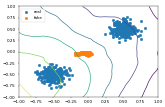

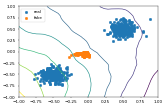

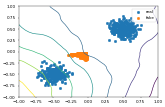

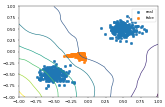

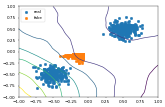

...

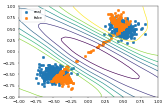

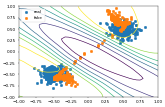

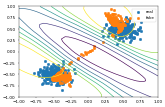

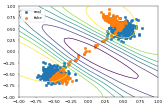

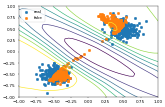

In [34]:
run_train(gen, disc, n_epochs, n_batch, n_z, n_critic)

# SoftPlus GAN

In [35]:
n_critic = 1 # Critic iterations. 5 for WGAN

In [36]:
from eeggan.modules.gan import GAN_Discriminator_SoftPlus, GAN_Generator_SoftPlus
class Generator_GAN_SP(GAN_Generator_SoftPlus):
    def __init__(self):
        super(Generator_GAN_SP,self).__init__()
        self.model = nn.Sequential(
            nn.Linear(2, model_dim),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Linear(model_dim, model_dim),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Linear(model_dim, model_dim),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Linear(model_dim, 2)
        )
    
    def forward(self, x):
        x = x.view(x.size(0), 2)
        out = self.model(x)
        return out

class Discriminator_GAN_SP(GAN_Discriminator_SoftPlus):
    def __init__(self):
        super(Discriminator_GAN_SP,self).__init__()
        self.model = nn.Sequential(
            nn.Linear(2, model_dim),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Linear(model_dim, model_dim),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Linear(model_dim, model_dim),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Linear(model_dim, 1),
            #nn.Sigmoid() # Vanilla GAN needs Sigmoid
        )
    
    def forward(self, x):
        out = self.model(x.view(x.size(0), 2))
        out = out.view(out.size(0), -1)
        return out

In [37]:
gen = Generator_GAN_SP()
gen.train_init(alpha=lr)
gen = gen.cuda()
gen = gen.train()

disc = Discriminator_GAN_SP()
disc.train_init(alpha=lr)
disc = disc.cuda()
disc = disc.train()

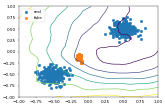

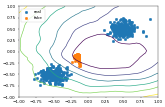

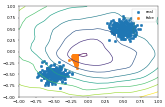

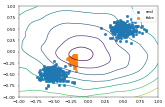

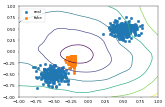

...

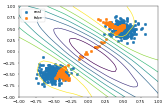

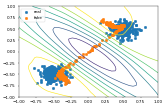

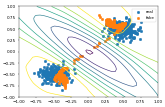

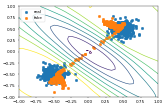

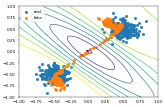

In [38]:
run_train(gen, disc, n_epochs, n_batch, n_z, n_critic)